In [36]:
!pip install deepface --user

## Face Recognition and cropping

In [37]:
from deepface import DeepFace
import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
import sys

In [38]:
backends = [
    "opencv",
    "ssd",
    "dlib",
    "mtcnn",
    "retinaface",
    "mediapipe"
]

default_backend = backends[0]

In [39]:
face = DeepFace.detectFace(
    img_path="deep_face_db/keanu_reaves/keanu01.png",
    target_size=(224, 224),
    detector_backend=default_backend
)

⚠️ Function detectFace is deprecated! Use extract_faces instead of this.


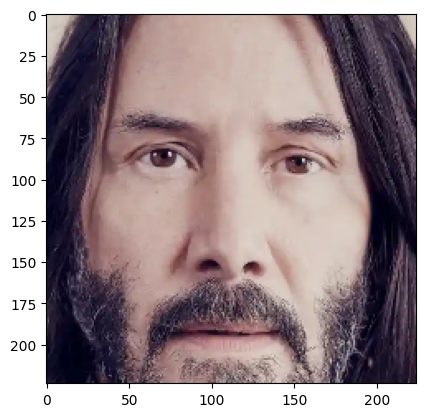

In [40]:
plt.imshow(face)

In [41]:
face = DeepFace.detectFace(
    img_path="deep_face_db/keanu_reaves/keanu01.png",
    target_size=(224, 224),
    detector_backend=backends[5]  # mediapipe
)

⚠️ Function detectFace is deprecated! Use extract_faces instead of this.


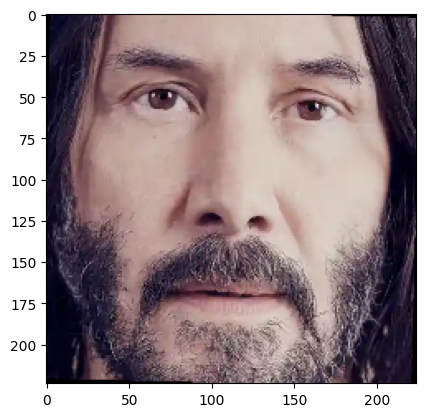

In [42]:
plt.imshow(face)

⚠️ Function detectFace is deprecated! Use extract_faces instead of this.
⚠️ Function detectFace is deprecated! Use extract_faces instead of this.
⚠️ Function detectFace is deprecated! Use extract_faces instead of this.
⚠️ Function detectFace is deprecated! Use extract_faces instead of this.
1/1 [==============================] - 0s 42ms/step
⚠️ Function detectFace is deprecated! Use extract_faces instead of this.
⚠️ Function detectFace is deprecated! Use extract_faces instead of this.


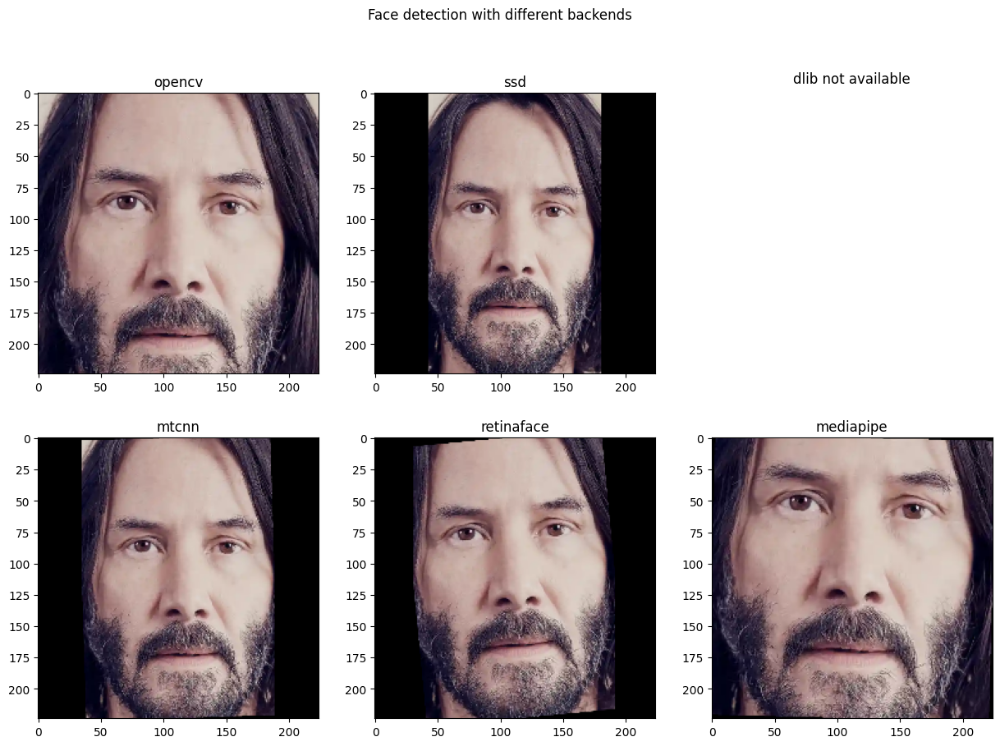

In [43]:
# plot all backend results in a single figure, use try except to avoid errors
fig, axs = plt.subplots(2, 3, figsize=(15, 10))
fig.suptitle('Face detection with different backends')

for i in range(2):
    for j in range(3):
        try:
            axs[i, j].imshow(DeepFace.detectFace(
                img_path="deep_face_db/keanu_reaves/keanu01.png",
                target_size=(224, 224),
                detector_backend=backends[i * 3 + j]
            ))
            axs[i, j].set_title(backends[i * 3 + j])
        except:
            axs[i, j].set_title(backends[i * 3 + j] + " not available")
            axs[i, j].axis('off')

plt.show()

## Face Verification and comparison

In [44]:
models = [
    "VGG-Face",
    "Facenet",
    "Facenet512",
    "OpenFace",
    "DeepFace",
    "DeepID",
    "ArcFace",
    "Dlib",
    "SFace",
]

default_model = models[0]

In [45]:
# face verification
verification_result = DeepFace.verify(img1_path="deep_face_db/keanu_reaves/keanu01.png",
                                      img2_path="deep_face_db/keanu_reaves/keanu02.png",
                                      model_name=default_model,
                                      detector_backend=default_backend,
                                      distance_metric="cosine")

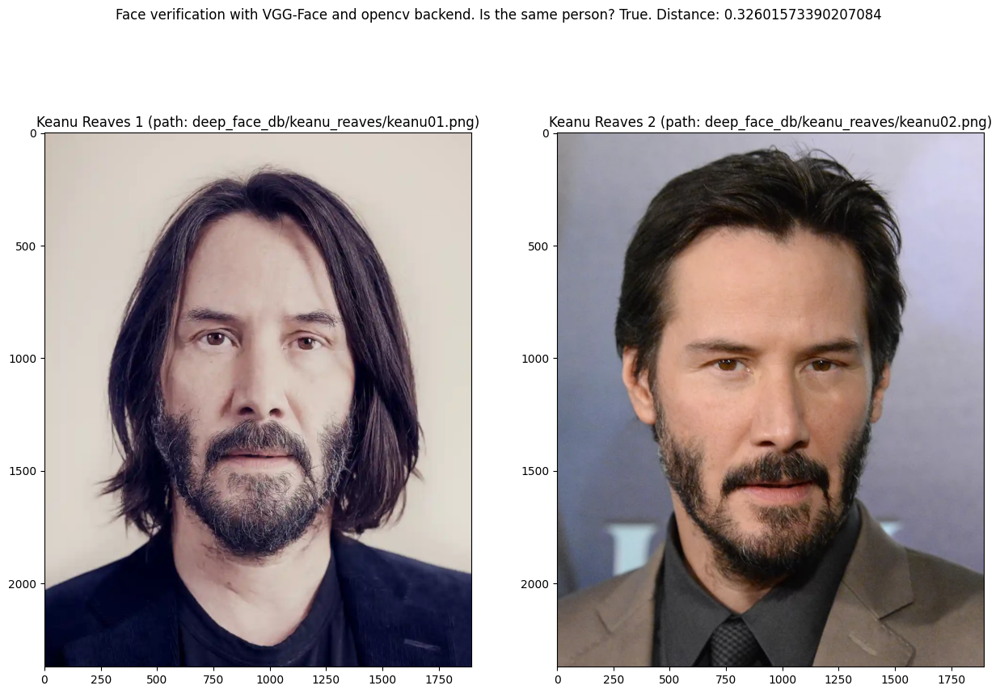

Is the same person? True


In [46]:
fig, axs = plt.subplots(1, 2, figsize=(15, 10))
fig.suptitle(
    'Face verification with ' + default_model + ' and ' + default_backend + ' backend. Is the same person? ' + str(
        verification_result["verified"]) + '. Distance: ' + str(verification_result["distance"]))

# inverse BGR to RGB
img1_path = "deep_face_db/keanu_reaves/keanu01.png"
img1 = cv2.imread(img1_path)
axs[0].imshow(img1[:, :, ::-1])
axs[0].set_title("Keanu Reaves 1 (path: " + img1_path + ")")

img2 = cv2.imread("deep_face_db/keanu_reaves/keanu02.png")
axs[1].imshow(img2[:, :, ::-1])
axs[1].set_title("Keanu Reaves 2 (path: deep_face_db/keanu_reaves/keanu02.png)")

plt.show()

print("Is the same person? " + str(verification_result["verified"]))

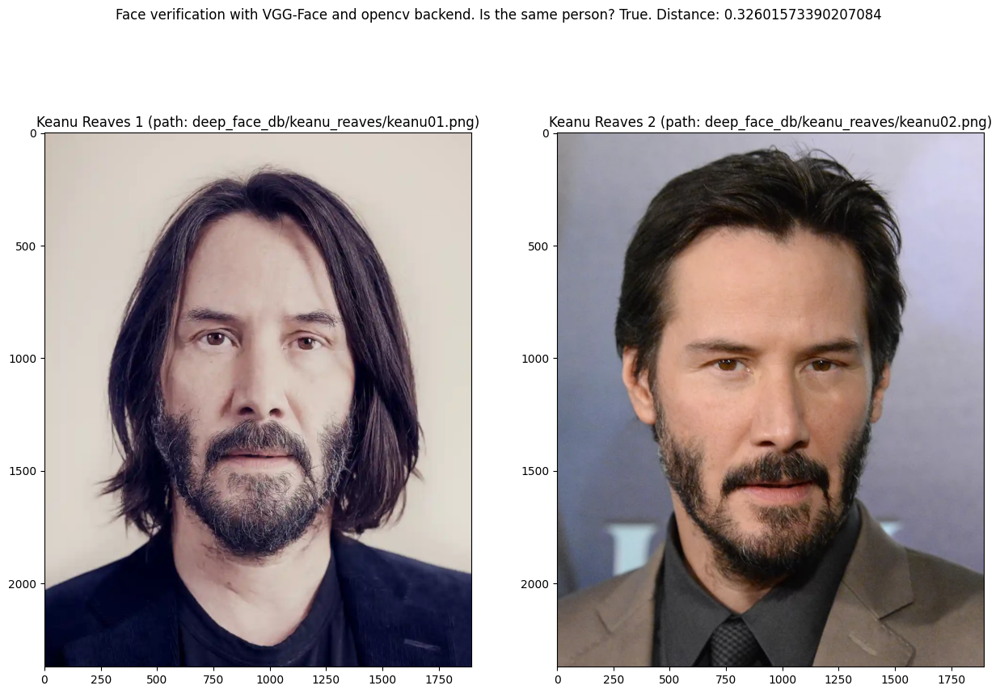

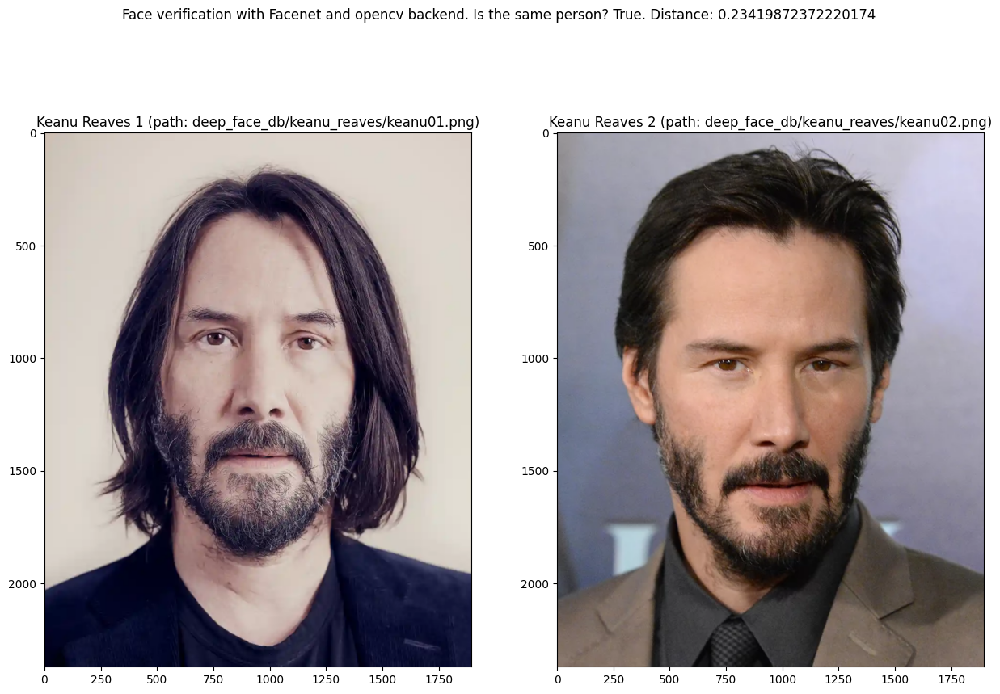

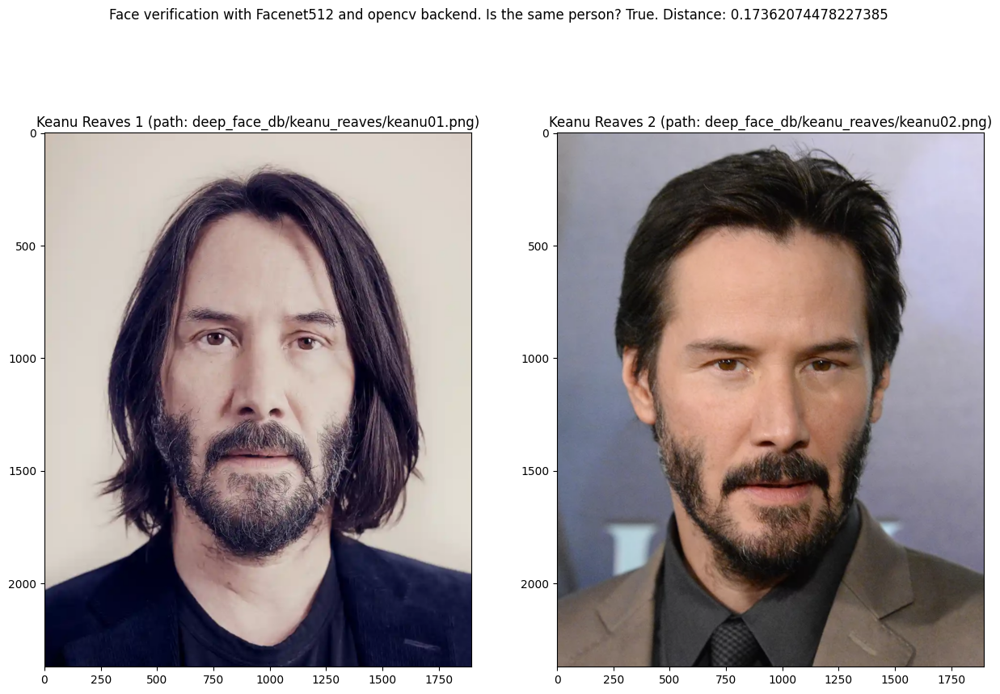

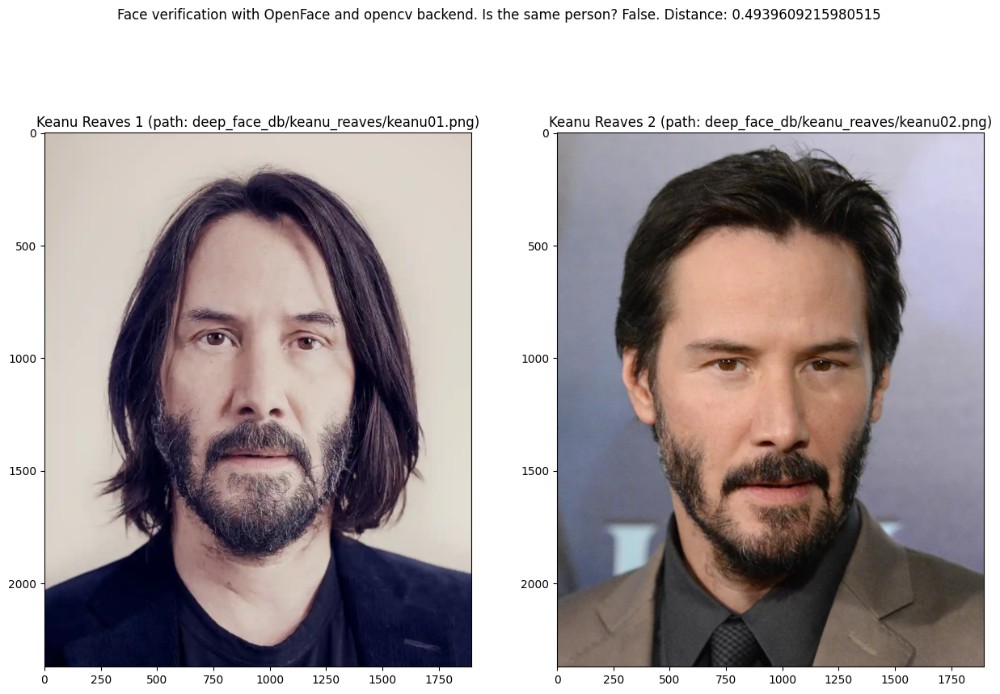

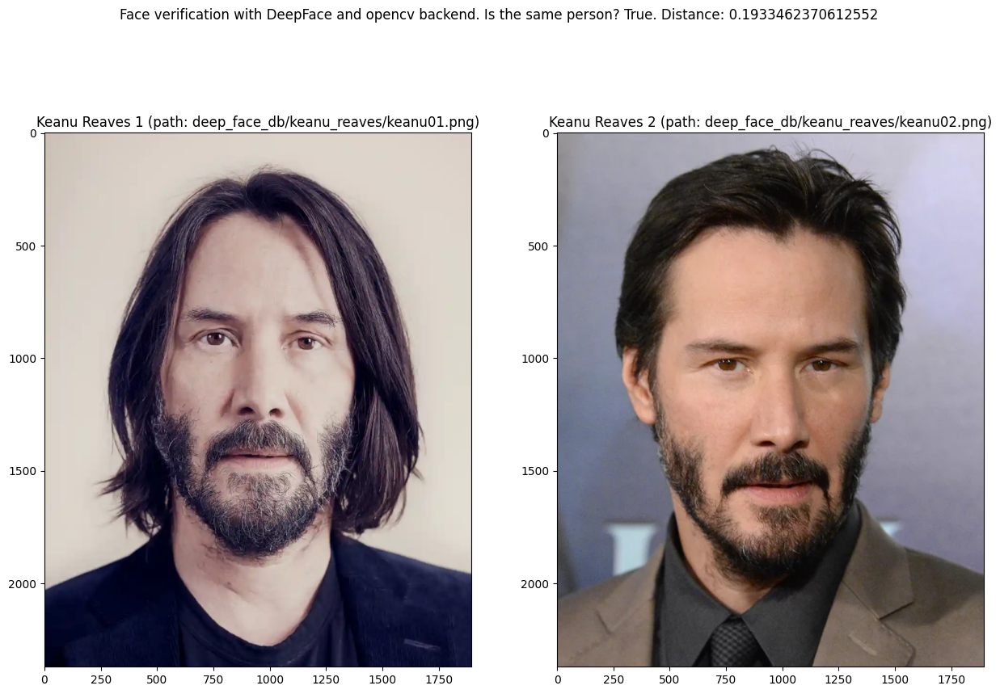

DeepID not available


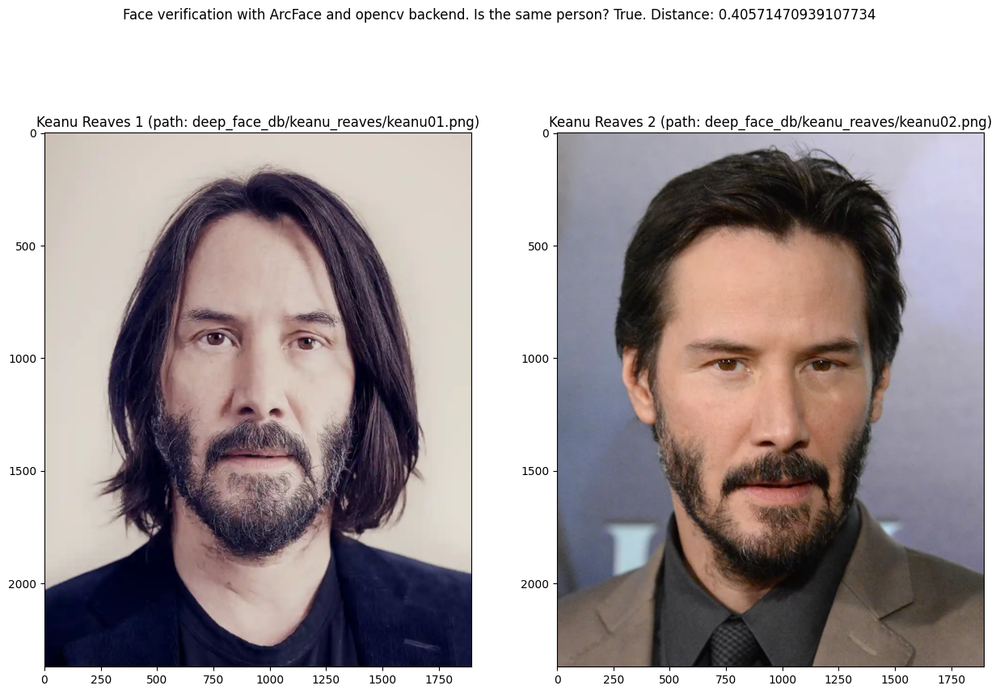

Dlib not available


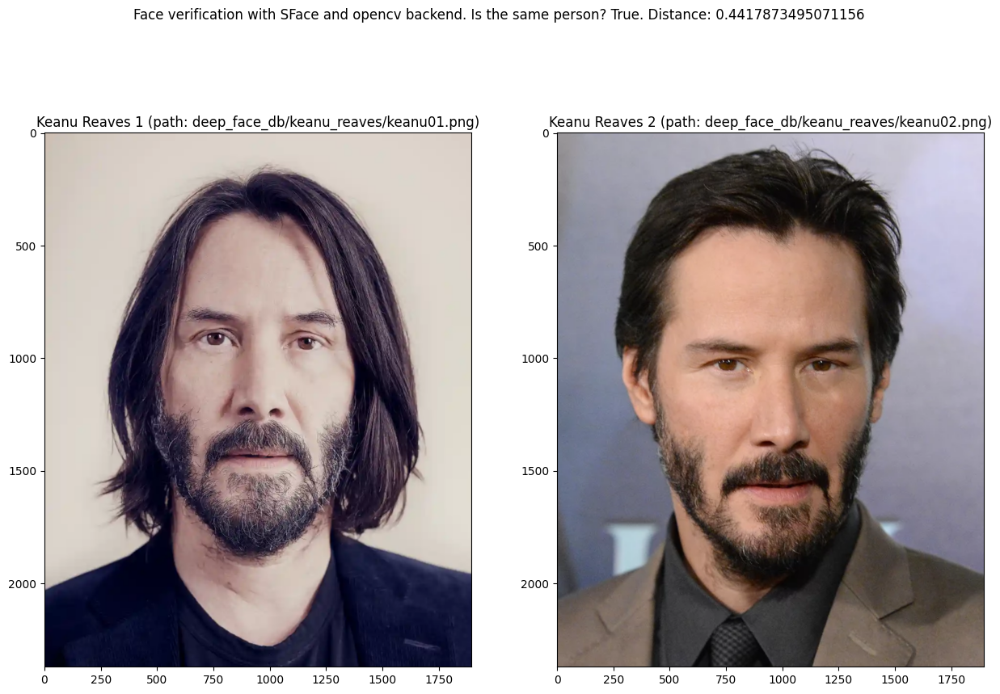

In [47]:
for model in models:
    try:
        # face verification
        face_attributes = DeepFace.verify(img1_path="deep_face_db/keanu_reaves/keanu01.png",
                                          img2_path="deep_face_db/keanu_reaves/keanu02.png",
                                          model_name=model,
                                          detector_backend=default_backend,
                                          distance_metric="cosine")

        fig, axs = plt.subplots(1, 2, figsize=(15, 10))
        fig.suptitle(
            'Face verification with ' + model + ' and ' + default_backend + ' backend. Is the same person? ' + str(
                face_attributes["verified"]) + '. Distance: ' + str(face_attributes["distance"]))

        # inverse BGR to RGB
        img1_path = "deep_face_db/keanu_reaves/keanu01.png"
        img1 = cv2.imread(img1_path)
        axs[0].imshow(img1[:, :, ::-1])
        axs[0].set_title("Keanu Reaves 1 (path: " + img1_path + ")")

        img2_path = "deep_face_db/keanu_reaves/keanu02.png"
        img2 = cv2.imread(img2_path)
        axs[1].imshow(img2[:, :, ::-1])
        axs[1].set_title("Keanu Reaves 2 (path: " + img2_path + ")")

        plt.show()

    except:
        print(model + " not available")

In [48]:
dfs = DeepFace.find(img_path="deep_face_db/keanu_reaves/keanu01.png",
                    db_path="deep_face_db/",
                    model_name=default_model,
                    detector_backend=default_backend,
                    distance_metric="cosine",
                    enforce_detection=False)

dfs

There are  56  representations found in  representations_vgg_face.pkl
find function lasts  0.850078821182251  seconds


[                                identity  source_x  source_y  source_w  \
 0  deep_face_db/keanu_reaves/keanu01.png       410       485      1101   
 1  deep_face_db/keanu_reaves/keanu03.png       410       485      1101   
 2  deep_face_db/keanu_reaves/keanu04.png       410       485      1101   
 3  deep_face_db/keanu_reaves/keanu08.png       410       485      1101   
 4  deep_face_db/keanu_reaves/keanu05.png       410       485      1101   
 5  deep_face_db/keanu_reaves/keanu02.png       410       485      1101   
 6  deep_face_db/keanu_reaves/keanu10.png       410       485      1101   
 7  deep_face_db/keanu_reaves/keanu07.png       410       485      1101   
 
    source_h  VGG-Face_cosine  
 0      1101     4.440892e-16  
 1      1101     2.002078e-01  
 2      1101     2.192202e-01  
 3      1101     2.230741e-01  
 4      1101     3.105329e-01  
 5      1101     3.260157e-01  
 6      1101     3.764340e-01  
 7      1101     3.855624e-01  ]

Deepface is a hybrid face recognition package. It currently wraps many state-of-the-art face recognition models: VGG-Face , Google FaceNet, OpenFace, Facebook DeepFace, DeepID, ArcFace, Dlib and SFace. The default configuration uses VGG-Face model.

In [49]:
#face verification
face_comparison = DeepFace.verify(img1_path="deep_face_db/scarlett johansson/scarlett01.png",
                                  img2_path="deep_face_db/scarlett johansson/scarlett02.png",
                                  model_name=models[0]
                                  )

#face recognition
dfs = DeepFace.find(img_path="deep_face_db/scarlett johansson/scarlett01.png",
                    db_path="deep_face_db/scarlett johansson/",
                    model_name=models[1]
                    )

#embeddings
embedding_objs = DeepFace.represent(img_path="deep_face_db/scarlett johansson/scarlett01.png",
                                    model_name=models[2]
                                    )

Finding representations: 100%|██████████| 10/10 [00:06<00:00,  1.49it/s]


Representations stored in deep_face_db/scarlett johansson//representations_facenet.pkl file.Please delete this file when you add new identities in your database.
find function lasts  7.4880547523498535  seconds


In [50]:
# delete the model from memory
del embedding_objs

# if there is a model at deep_face_db/scarlett johansson/representations_facenet.pkl delete it too
if os.path.isfile("deep_face_db/scarlett johansson/representations_facenet.pkl"):
    os.remove("deep_face_db/scarlett johansson/representations_facenet.pkl")

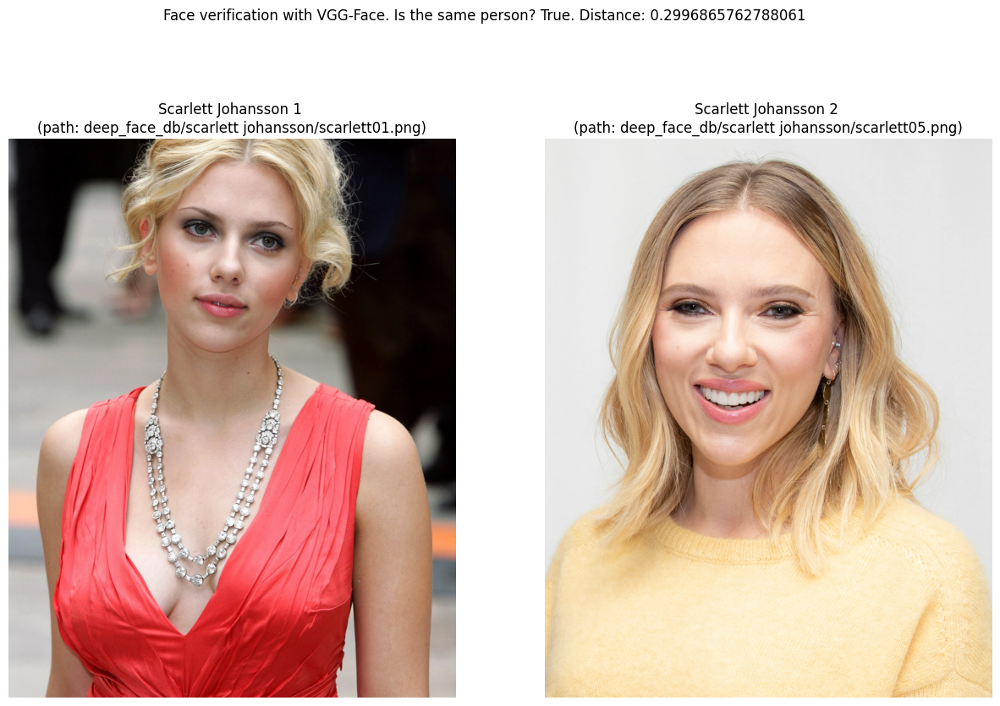

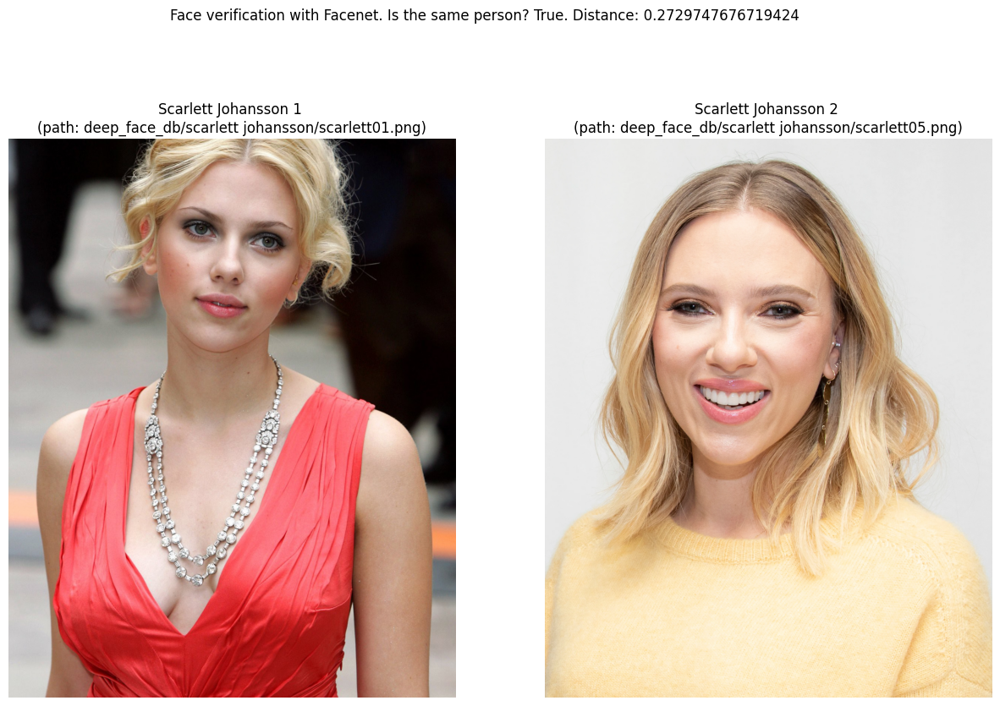

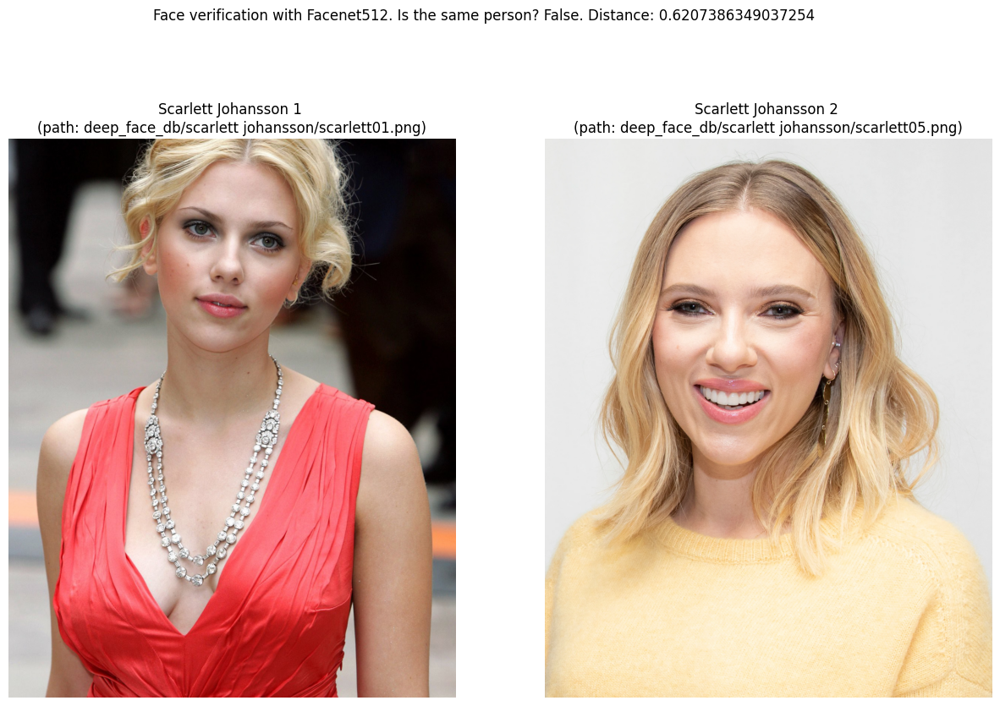

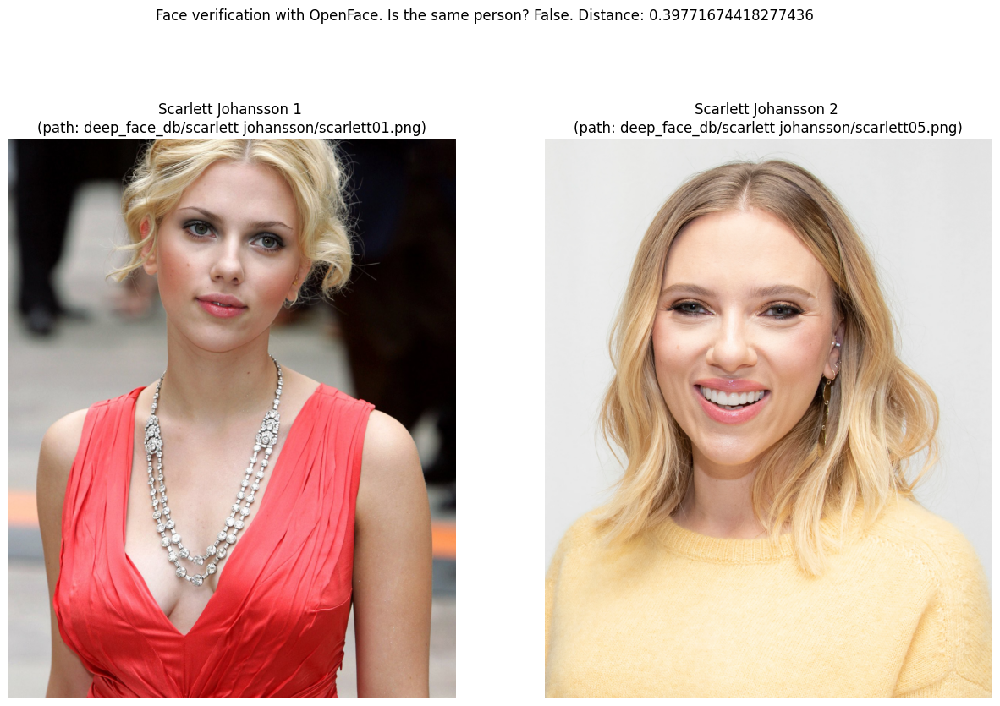

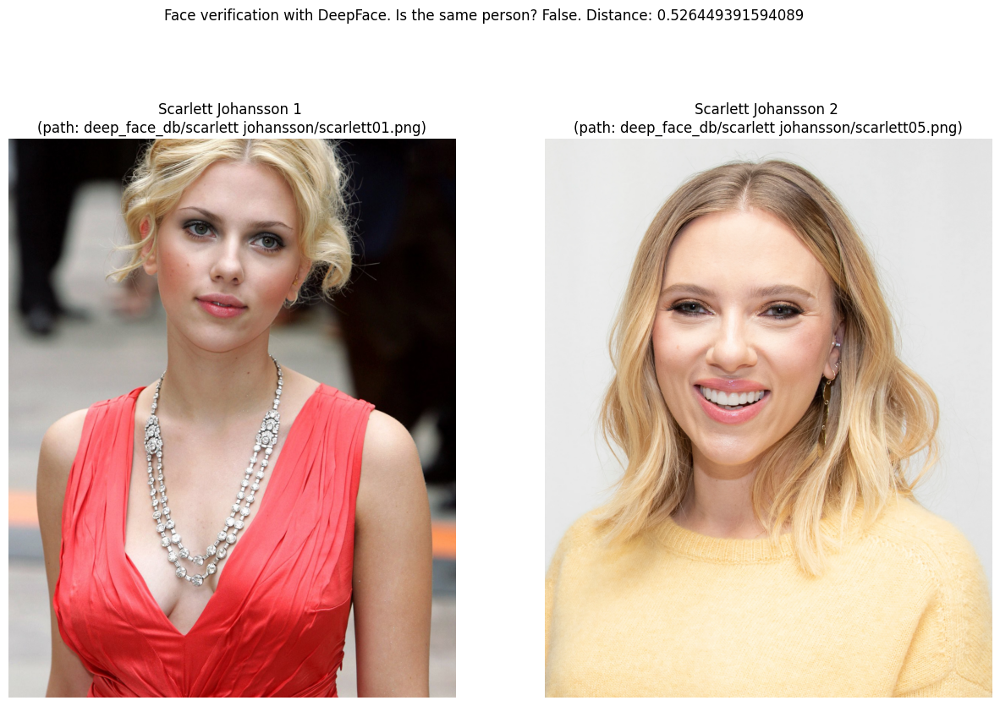

DeepID not available


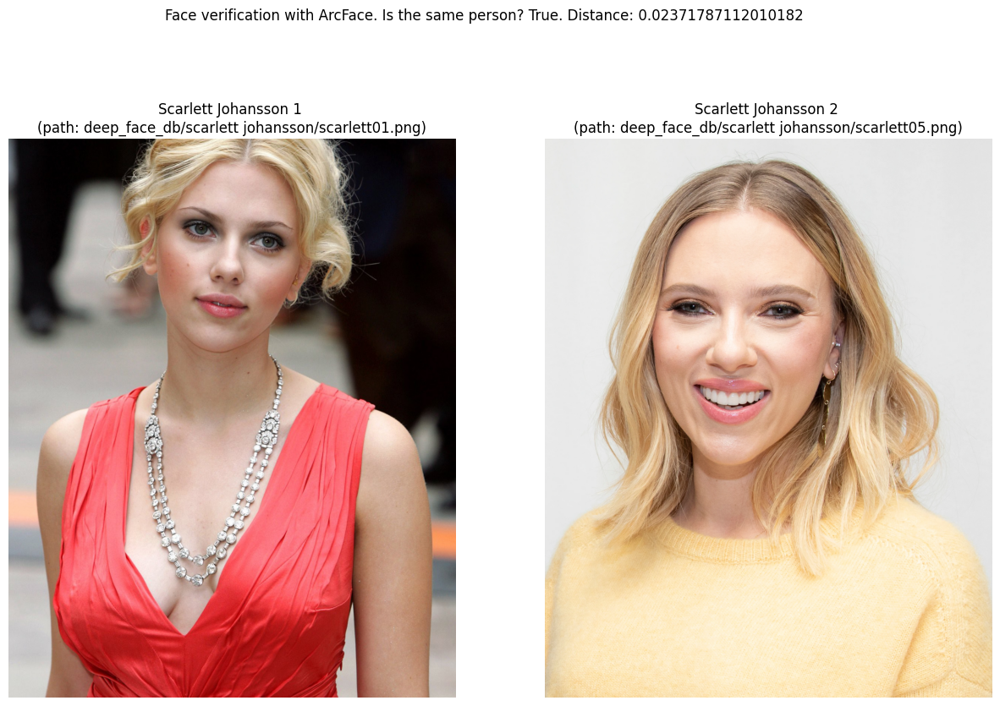

Dlib not available


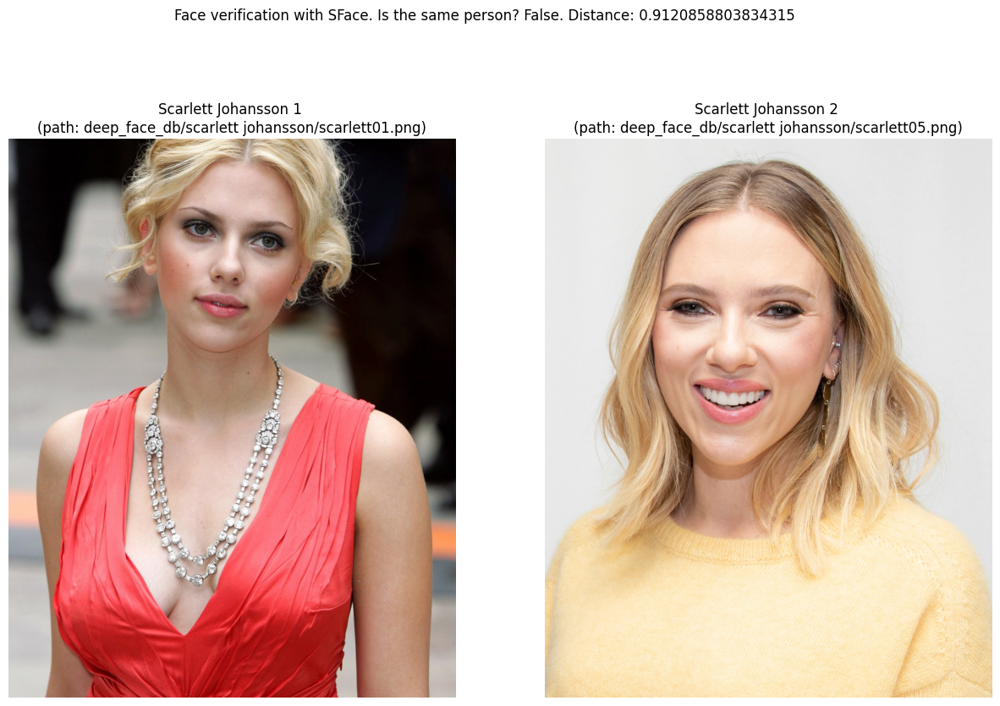

In [51]:
for model in models:

    try:

        img1_path = "deep_face_db/scarlett johansson/scarlett01.png"
        img2_path = "deep_face_db/scarlett johansson/scarlett05.png"
        face_comparison = DeepFace.verify(img1_path=img1_path, img2_path=img2_path, model_name=model)

        # plot the result
        fig, axs = plt.subplots(1, 2, figsize=(15, 10))
        axs[0].imshow(cv2.imread(img1_path)[:, :, ::-1])
        axs[0].set_title("Scarlett Johansson 1 \n(path: " + img1_path + ")")
        axs[0].axis('off')

        axs[1].imshow(cv2.imread(img2_path)[:, :, ::-1])
        axs[1].set_title("Scarlett Johansson 2 \n(path: " + img2_path + ")")
        axs[1].axis('off')

        fig.suptitle('Face verification with ' + model + '. Is the same person? ' + str(
            face_comparison["verified"]) + '. Distance: ' + str(face_comparison["distance"]))

        plt.show()

    except:
        print(model + " not available")

### Face Models


FaceNet, VGG-Face, ArcFace and Dlib are over-performing ones based on experiments. You can find out the scores of those models below on both Labeled Faces in the Wild and YouTube Faces in the Wild data sets declared by its creators.

| Model           | 	LFW Score	 | YTF Score |
|-----------------|-------------|-----------|
| Facenet512      | 	99.65%     | 	-        |
| SFace	   | 99.60%      | 	-     |
| ArcFace         | 	99.41%     | 	-        |
| Dlib            | 	99.38%     | 	-        |
| Facenet         | 	99.20%     | 	-        |
| VGG-Face        | 	98.78%     | 	97.40%   |
| Human-beings    | 	97.53%     | 	-        |
| OpenFace        | 	93.80%     | 	-        |
| DeepID          | 	-          | 	97.05%   |

Face recognition models are actually CNN models and they expect standard sized inputs. So, resizing is required before representation. To avoid deformation, deepface adds black padding pixels according to the target size argument after detection and alignment.

RetinaFace and MTCNN seem to overperform in detection and alignment stages but they are much slower. If the speed of your pipeline is more important, then you should use opencv or ssd. On the other hand, if you consider the accuracy, then you should use retinaface or mtcnn.

The performance of RetinaFace is very satisfactory even in the crowd as seen in the following illustration. Besides, it comes with an incredible facial landmark detection performance. Highlighted red points show some facial landmarks such as eyes, nose and mouth. That's why, alignment score of RetinaFace is high as well.

## Facial Attribute Analysis

Deepface supports facial attribute analysis as well. It is based on the VGG-Face model. You can find the list of attributes below.

In [52]:
face_attributes = DeepFace.analyze(
    img_path="deep_face_db/scarlett johansson/scarlett05.png",
    detector_backend="opencv",
    align=True
)

face_attributes

Action: race: 100%|██████████| 4/4 [00:00<00:00,  5.58it/s]  


[{'emotion': {'angry': 1.0898348890009402e-06,
   'disgust': 2.8950803478708723e-12,
   'fear': 9.156541977972665e-05,
   'happy': 99.74772334098816,
   'sad': 0.001657299799262546,
   'surprise': 8.204055745864025e-06,
   'neutral': 0.2505216747522354},
  'dominant_emotion': 'happy',
  'region': {'x': 310, 'y': 343, 'w': 1001, 'h': 1001},
  'age': 36,
  'gender': {'Woman': 63.77241611480713, 'Man': 36.22758388519287},
  'dominant_gender': 'Woman',
  'race': {'asian': 1.8391622230410576,
   'indian': 0.806767400354147,
   'black': 0.03538987075444311,
   'white': 78.84004712104797,
   'middle eastern': 11.68973296880722,
   'latino hispanic': 6.788896024227142},
  'dominant_race': 'white'}]

In [53]:
# print the attributes
for attribute in face_attributes[0].keys():
    print(attribute)

# print the dominant emotion
print(face_attributes[0]['dominant_emotion'])

emotion
dominant_emotion
region
age
gender
dominant_gender
race
dominant_race
happy


error occurred, possibly no face detected


Action: emotion: 100%|██████████| 1/1 [00:00<00:00, 14.88it/s]


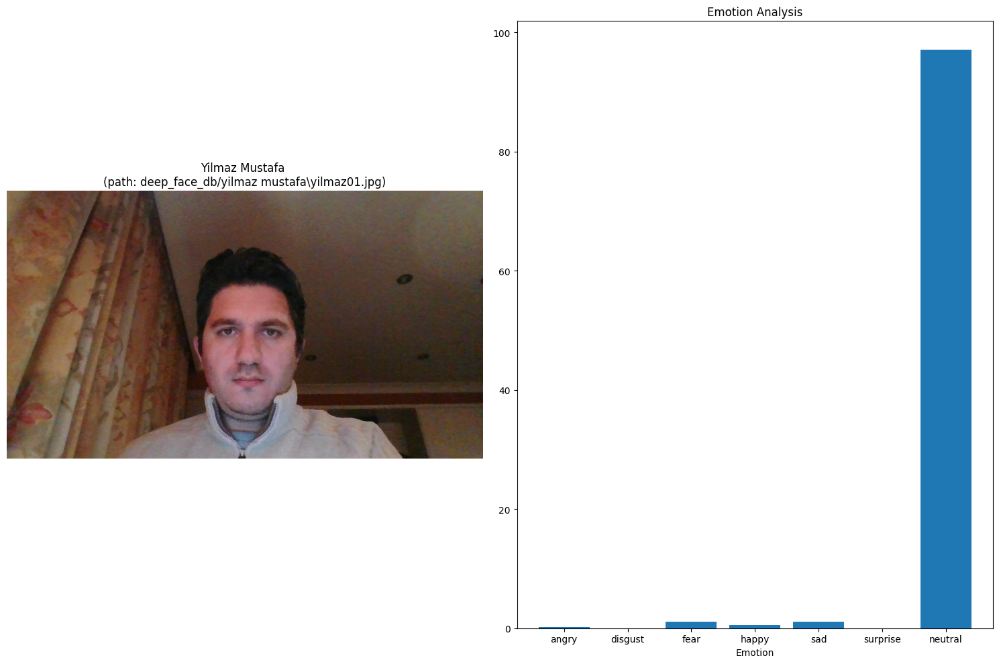

Action: emotion: 100%|██████████| 1/1 [00:00<00:00, 16.13it/s]


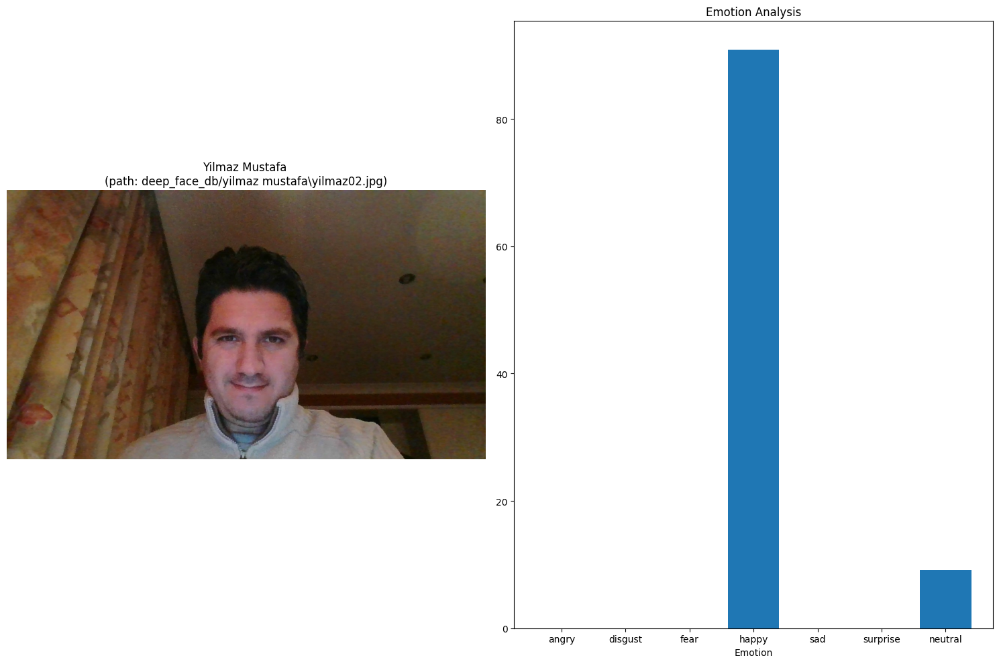

Action: emotion: 100%|██████████| 1/1 [00:00<00:00, 13.64it/s]


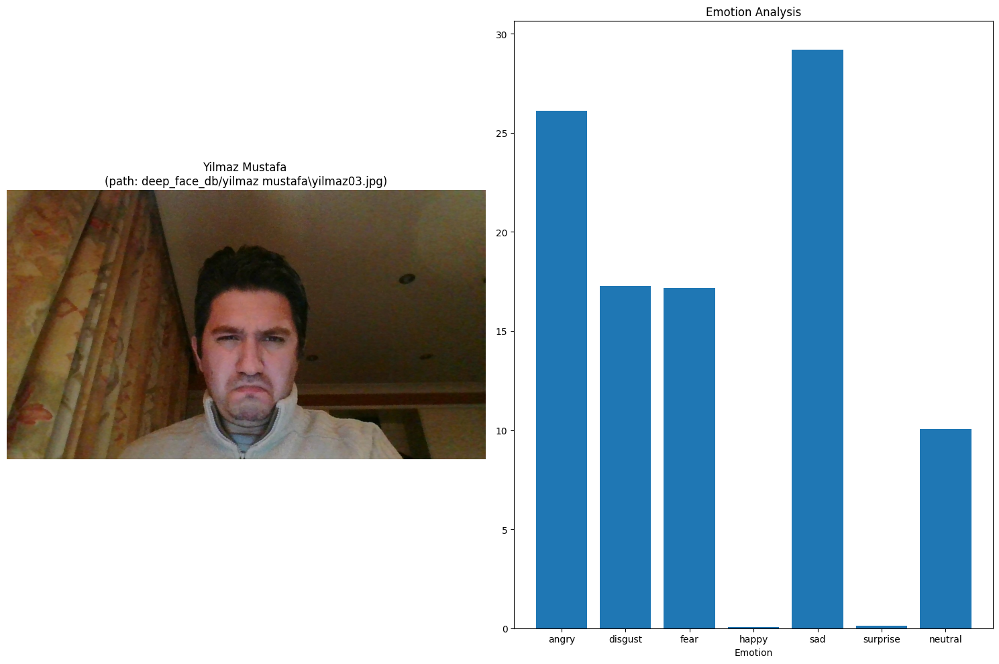

Action: emotion: 100%|██████████| 1/1 [00:00<00:00, 13.76it/s]


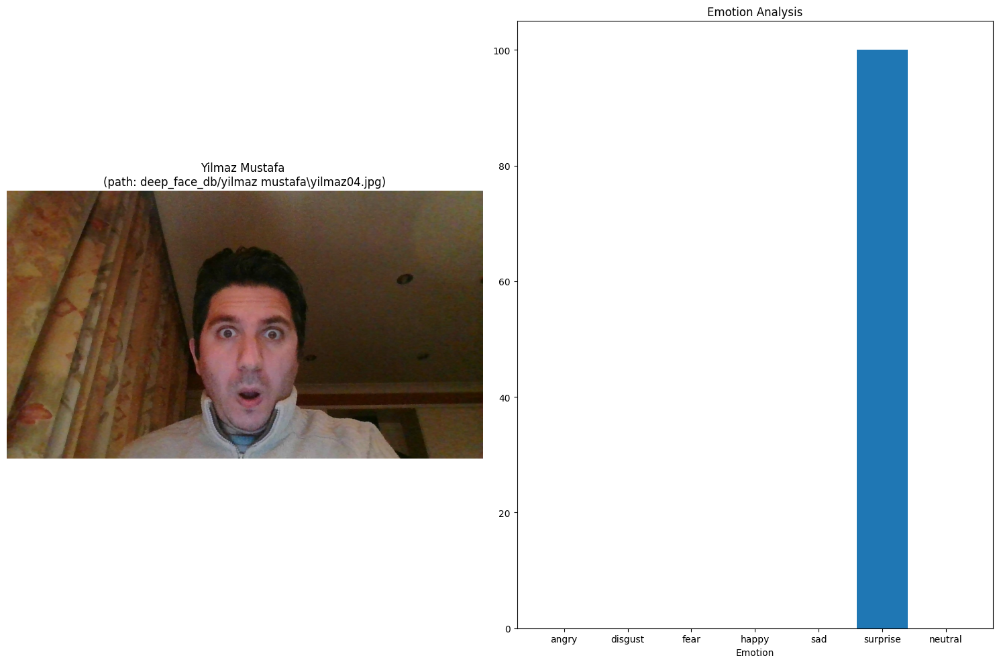

Action: emotion: 100%|██████████| 1/1 [00:00<00:00, 15.73it/s]


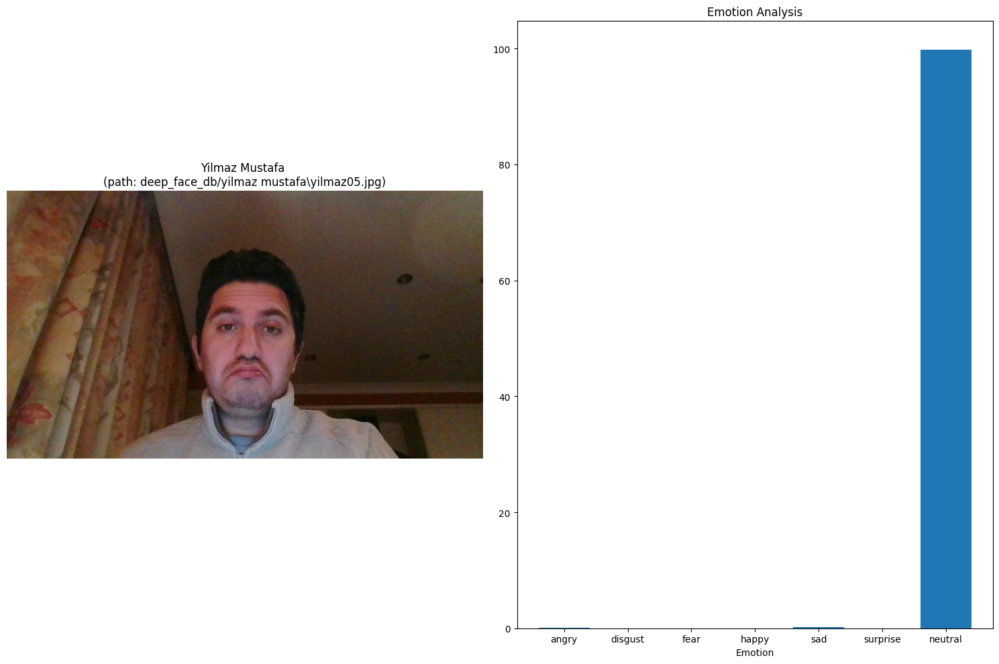

Action: emotion: 100%|██████████| 1/1 [00:00<00:00, 15.88it/s]


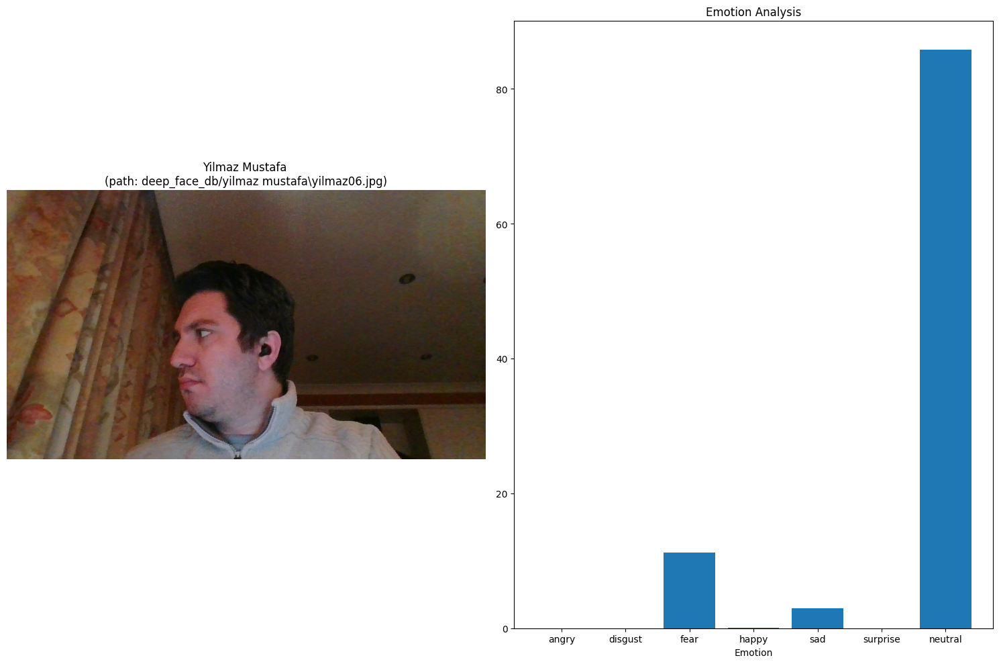

error occurred, possibly no face detected
error occurred, possibly no face detected


Action: emotion: 100%|██████████| 1/1 [00:00<00:00, 14.80it/s]


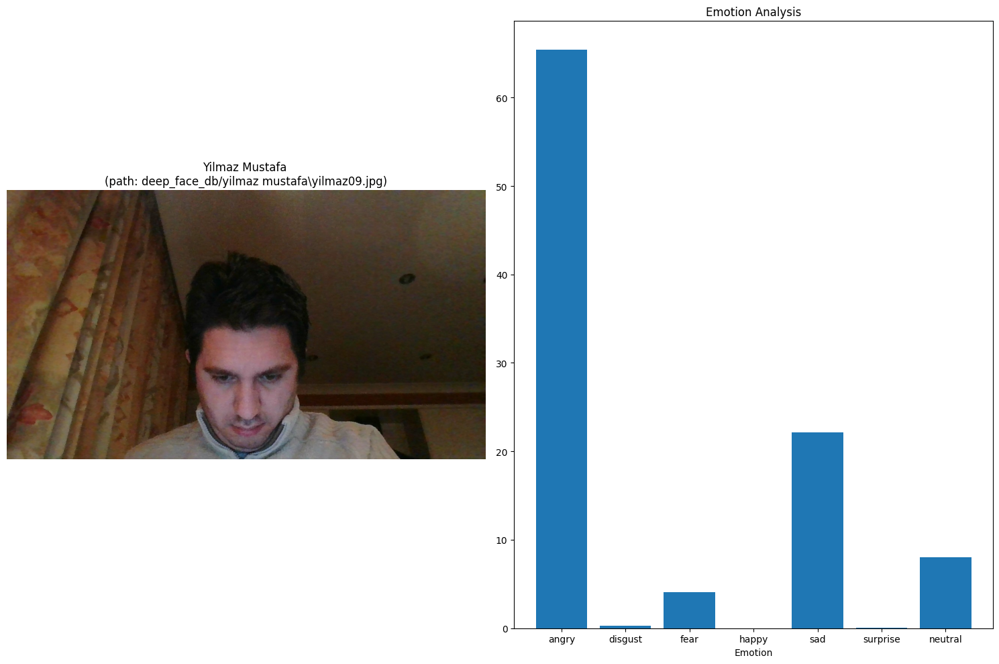

Action: emotion: 100%|██████████| 1/1 [00:00<00:00,  7.66it/s]


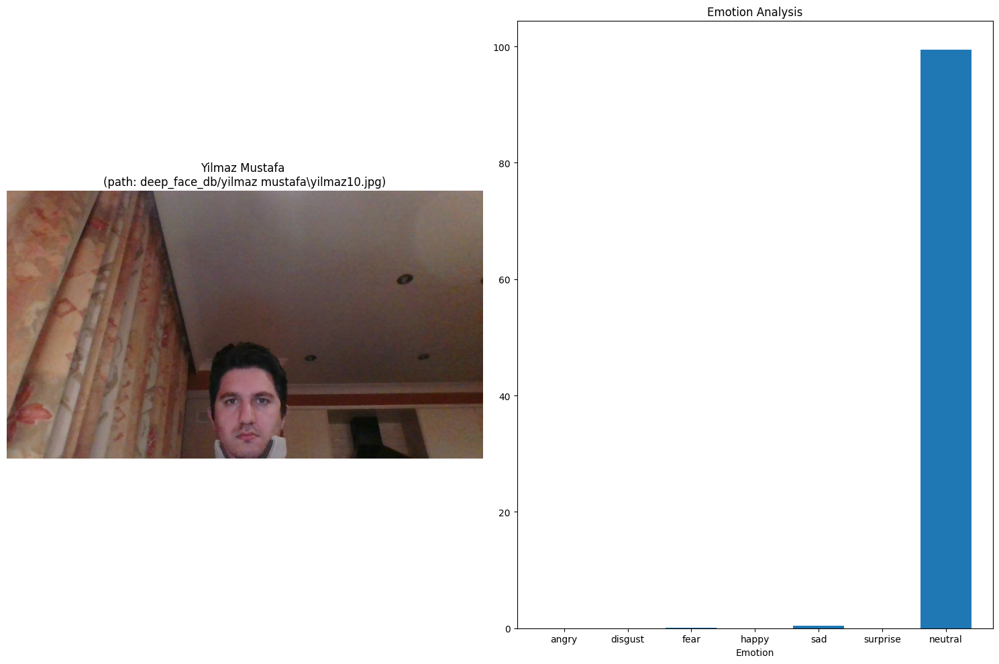

In [54]:
from glob import glob

imgs = glob("deep_face_db/yilmaz mustafa/*")

for img in imgs:

    try:

        emdf = DeepFace.analyze(img_path=img, actions=['emotion'], detector_backend="opencv", align=True)

        # Get the emotion data from the dictionary
        emotion_data = emdf[0]['emotion']

        # convert to dataframe
        emotion_df = pd.DataFrame(emotion_data, index=[0])

        fig, axs = plt.subplots(1, 2, figsize=(15, 10))
        axs[0].imshow(cv2.imread(img)[:, :, ::-1])
        axs[0].set_title("Yilmaz Mustafa \n(path: " + img + ")")
        axs[0].axis('off')

        axs[1].bar(emotion_df.columns, emotion_df.iloc[0])
        axs[1].set_title("Emotion Analysis")
        axs[1].set_xlabel("Emotion")

        plt.tight_layout()

        plt.show()

    except:
        print("error occurred, possibly no face detected")

## Real Time Analysis

You can run deepface for real time videos as well. Stream function will access your webcam and apply both face recognition and facial attribute analysis. The function starts to analyze a frame if it can focus a face sequentially 5 frames. Then, it shows results 5 seconds.

In [ ]:
# if there is a model at deep_face_db/yilmaz mustafa/representations_facenet.pkl delete it too
if os.path.isfile("deep_face_db/yilmaz mustafa/representations_facenet.pkl"):
    os.remove("deep_face_db/yilmaz mustafa/representations_facenet.pkl")

if os.path.isfile("deep_face_db/yilmaz mustafa/representations_vgg_face.pkl"):
    os.remove("deep_face_db/yilmaz mustafa/representations_vgg_face.pkl")

DeepFace.stream(db_path="deep_face_db/yilmaz mustafa",
                model_name=default_model,
                detector_backend=default_backend,
                distance_metric="cosine")



In [ ]:
import cv2
from deepface import DeepFace
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

default_backend = "opencv"
default_model = "Facenet"


# ask user to select a video file
selection = input(
    "Select a video file to test the model (Default: Webcam (0) or enter the absolute path to a video file):")

if selection == "0" or selection == "" or selection is None:
    cam = cv2.VideoCapture(0)
else:
    cam = cv2.VideoCapture(selection)

# set the resolution of the camera to full screen size
# get the width and height of the screen
width = int(cam.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cam.get(cv2.CAP_PROP_FRAME_HEIGHT))
# set the width and height, and UNSUCCESSFULLY set the exposure time
cam.set(cv2.CAP_PROP_FRAME_WIDTH, width)
cam.set(cv2.CAP_PROP_FRAME_HEIGHT, height)
cam.set(cv2.CAP_PROP_FPS, 60)

# Define min window size to be recognized as a face
minW = 0.1 * cam.get(3)
minH = 0.1 * cam.get(4)

while True:
    ret, img = cam.read()
    img = cv2.flip(img, 1)  # Flip vertically
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    try:

        # predict the emotion
        emotion = DeepFace.analyze(img_path=img, actions=['emotion'], detector_backend=default_backend, align=True, silent=True)

        # get the emotion data from the dictionary
        emotion_data = emotion[0]['emotion']

        # convert to dataframe
        emotion_df = pd.DataFrame(emotion_data, index=[0])

        # get the dominant emotion
        emotion_label = emotion_df.idxmax(axis=1)[0]

        # draw the emotion label at the bottom of the frame and display it such as "Happy: 0.99, Sad: 0.01"
        cv2.putText(img, emotion_label + ": " + str(emotion_df[emotion_label][0]), (10, height - 10), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2, cv2.LINE_AA)

        # if the emotion is happy, then draw a green rectangle around the face
        if emotion_label == "happy":
            cv2.rectangle(img, (int(minW), int(minH)), (int(width - minW), int(height - minH)), (0, 255, 0), 2)

        # if the emotion is sad, then draw a red rectangle around the face
        if emotion_label == "sad":
            cv2.rectangle(img, (int(minW), int(minH)), (int(width - minW), int(height - minH)), (0, 0, 255), 2)

        # if the emotion is angry, then draw a blue rectangle around the face
        if emotion_label == "angry":
            cv2.rectangle(img, (int(minW), int(minH)), (int(width - minW), int(height - minH)), (255, 0, 0), 2)

        # if the emotion is neutral, then draw a yellow rectangle around the face
        if emotion_label == "neutral":
            cv2.rectangle(img, (int(minW), int(minH)), (int(width - minW), int(height - minH)), (0, 255, 255), 2)

    except:
        # draw error message if no face detected
        cv2.putText(img, "No face detected", (10, height - 10), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2, cv2.LINE_AA)

    # show the frame
    cv2.imshow('Emotion Recognition', img)

    # press q to exit
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break


cam.release()
cv2.destroyAllWindows()


## Crowd Face Recognition

In [ ]:
from retinaface import RetinaFace
import matplotlib.pyplot as plt
import cv2

In [ ]:
faces = RetinaFace.extract_faces(img_path = "img.jpg", align = True)
for face in faces:
  plt.imshow(face)
  plt.show()